# Generate scenarios of load and solar capacity factor

In [1]:
#using Pkg
#Pkg.add(["StatsBase", "Distributions"])
using CSV, DataFrames, StatsBase, Distributions, Plots

Load data

In [ ]:
load = CSV.read("DATA/Load/load.csv", DataFrame)[1:8760, :]
cf = CSV.read("DATA/Capacity_factor/capacity_factor.csv", DataFrame)

Row,Time stamp,Capacity factor
,String31,Float64
1,1900-01-01 00:00:00,-0.000648558
2,1900-01-01 01:00:00,-0.000648558
3,1900-01-01 02:00:00,-0.000648558
4,1900-01-01 03:00:00,-0.000648558
5,1900-01-01 04:00:00,-0.000648558
6,1900-01-01 05:00:00,-0.000648558
7,1900-01-01 06:00:00,-0.000648558
8,1900-01-01 07:00:00,0.0114836
9,1900-01-01 08:00:00,0.2367


In [ ]:
distributions = [#=Beta,=# Exponential, LogNormal, Normal, Gamma,#= Laplace, Pareto,=# Rayleigh, InverseGaussian,#= Uniform,=# Weibull]

7-element Vector{UnionAll}:
 Exponential
 LogNormal
 Normal
 Gamma
 Rayleigh
 InverseGaussian
 Weibull

In [ ]:
max_l = maximum(load[:, :load])
data_load = load[:, :load]/max_l

8760-element Vector{Float64}:
 0.6312891301526847
 0.6176388632739018
 0.6026487613499103
 0.5854693366601376
 0.5689206346174018
 0.5657908202648831
 0.5493534127364575
 0.5261654358628488
 0.5145824877363636
 0.5128188203325169
 ⋮
 0.6018400083888136
 0.602472450102999
 0.5967078437298002
 0.58788183313784
 0.5793433221051206
 0.5707420341756192
 0.5594356388621012
 0.5626697958509815
 0.5809723378059526

In [ ]:
FITS = Dict()
min_loss = -Inf
best_dist = nothing
for dist in distributions
    #println(dist)
    fit = fit_mle(dist, data_load)
    #println(fit)
    loss = sum(logpdf.(fit, data_load))
    if loss > min_loss
        min_loss = loss
        best_dist = dist
    end
    #println("Loss: ", loss)
    FITS[dist] = (fit, loss)
end

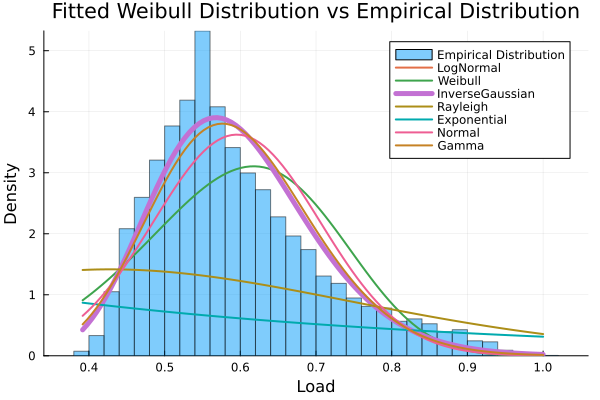

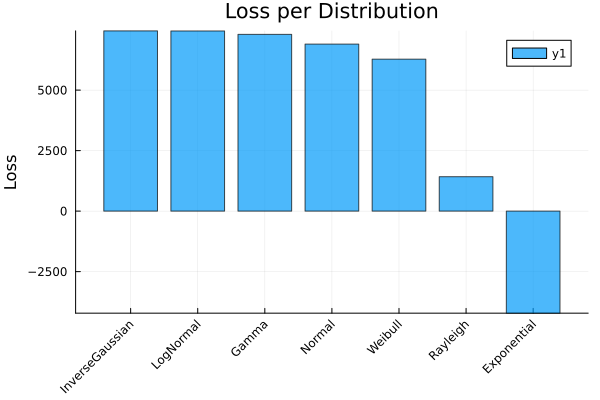

Best distribution'l loss : 7448.571976701031


In [ ]:
# Plot the empirical distribution
plt = histogram(data_load, normalize=true, alpha=0.5, label="Empirical Distribution", bins=50)

# Plot the fitted Weibull distribution
x = range(minimum(data_load), stop=maximum(data_load), length=100)

for (dist, (fit, loss)) in FITS
    if dist == best_dist
        s = 5
    else
        s=2
    end
    y = pdf.(fit, x)
    plot!(x, y, label=string(dist), linewidth=s)
end

# Add labels and legend
xlabel!("Load")
ylabel!("Density")
title!("Fitted Weibull Distribution vs Empirical Distribution")
display(plt)


# Sort the FITS dictionary by loss in decreasing order
sorted_fits = sort(collect(FITS), by=x -> x[2][2], rev=true)

# Create a new plot for the loss plot
plt = bar(string.(first.(sorted_fits)), [loss for (_, (_, loss)) in sorted_fits], alpha=0.7, xrotation=45)
xlabel!("Distribution")
ylabel!("Loss")
title!("Loss per Distribution")
display(plt)

println("Best distribution'l loss : ", maximum([loss for (_, (_, loss)) in sorted_fits]))

### By season

In [ ]:
load_by_season = Dict()
for season in ["winter", "spring", "summer", "fall"]
    load_by_season[season] = load[load[:, :season] .== season, :load]/max_l
end

In [ ]:
FITS = Dict(season => Dict() for season in ["winter", "spring", "summer", "fall"])
for season in ["winter", "spring", "summer", "fall"]
    min_loss = -Inf
    best_dist = nothing
    for dist in distributions
        #println(dist)
        data = load_by_season[season]
        fit = fit_mle(dist, data)
        #println(fit)
        loss = sum(logpdf.(fit, data))
        if loss > min_loss
            min_loss = loss
            best_dist = dist
        end
        #println("Loss: ", loss)
        FITS[season][dist] = (fit, loss)
    end
end

In [ ]:
total_min_loss = sum(maximum([loss for (_, (_, loss)) in FITS[season]]) for season in ["winter", "spring", "summer", "fall"])
println("Total minimum loss: ", total_min_loss)

Total minimum loss: 8721.599552317248


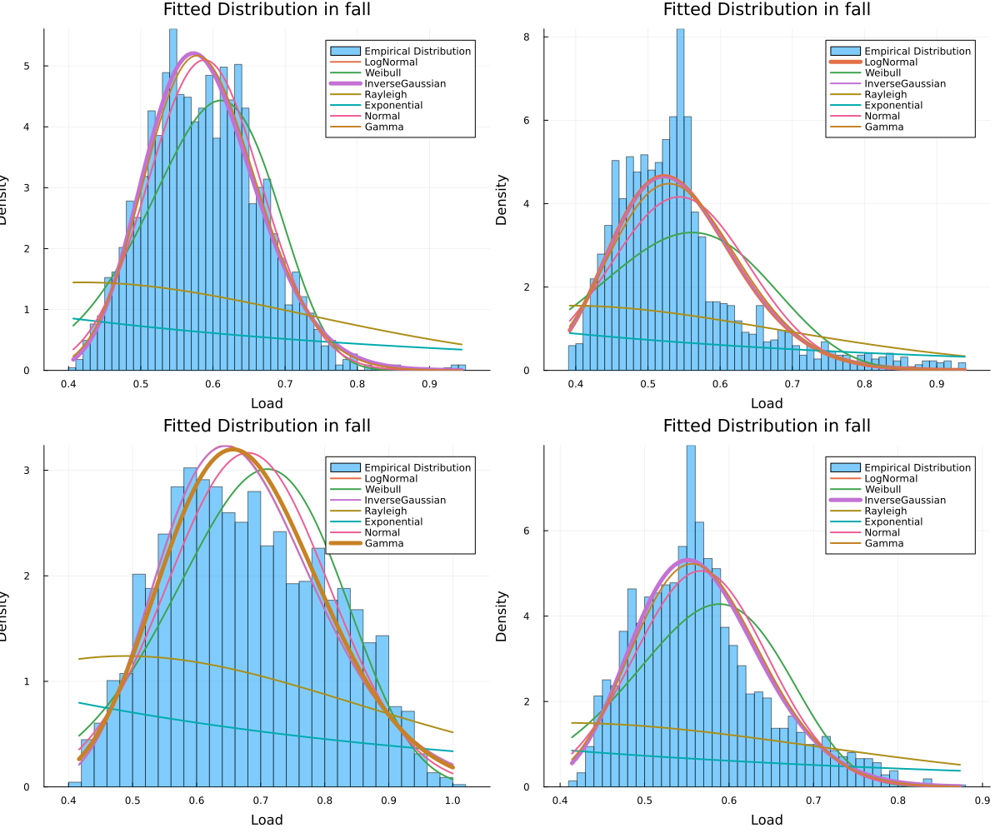

In [ ]:
plot(layout=(2, 2), size=(1200, 1000))
sp = 1
for season in ["winter", "spring", "summer", "fall"]
    F = FITS[season]
    # Plot the empirical distribution
    plt = histogram!(subplot=sp, load_by_season[season], normalize=true, alpha=0.5, label="Empirical Distribution", bins=50)

    # Plot the fitted Weibull distribution
    x = range(minimum(load_by_season[season]), stop=maximum(load_by_season[season]), length=100)

    best_dist = argmax([loss for (_, (_, loss)) in F])
    best_dist = [dist for (dist, (_, _)) in F][best_dist]

    for (dist, (fit, loss)) in F
        if dist == best_dist
            s = 5
        else
            s=2
        end
        y = pdf.(fit, x)
        plot!(subplot=sp, x, y, label=string(dist), linewidth=s)
    end

    # Add labels and legend
    xlabel!("Load")
    ylabel!("Density")
    title!("Fitted Distribution in $season")
    sp+=1
end
display(plt)

## By hour

In [ ]:
load_by_hour = Dict()
for h in 0:23
    load_by_hour[h+1] = load[load[:, :hour] .== h, :load]/max_l
end

FITS = Dict(h => Dict() for  h in 1:24)
for  h in 1:24
    min_loss = -Inf
    best_dist = nothing
    for dist in distributions
        #println(dist)
        data = load_by_hour[h]
        fit = fit_mle(dist, data)
        #println(fit)
        loss = sum(logpdf.(fit, data))
        if loss > min_loss
            min_loss = loss
            best_dist = dist
        end
        #println("Loss: ", loss)
        FITS[h][dist] = (fit, loss)
    end
end

In [ ]:
total_min_loss = sum(maximum([loss for (_, (_, loss)) in FITS[h]]) for h in 1:24)
println("Total minimum loss: ", total_min_loss)

Total minimum loss: 9021.463261552857


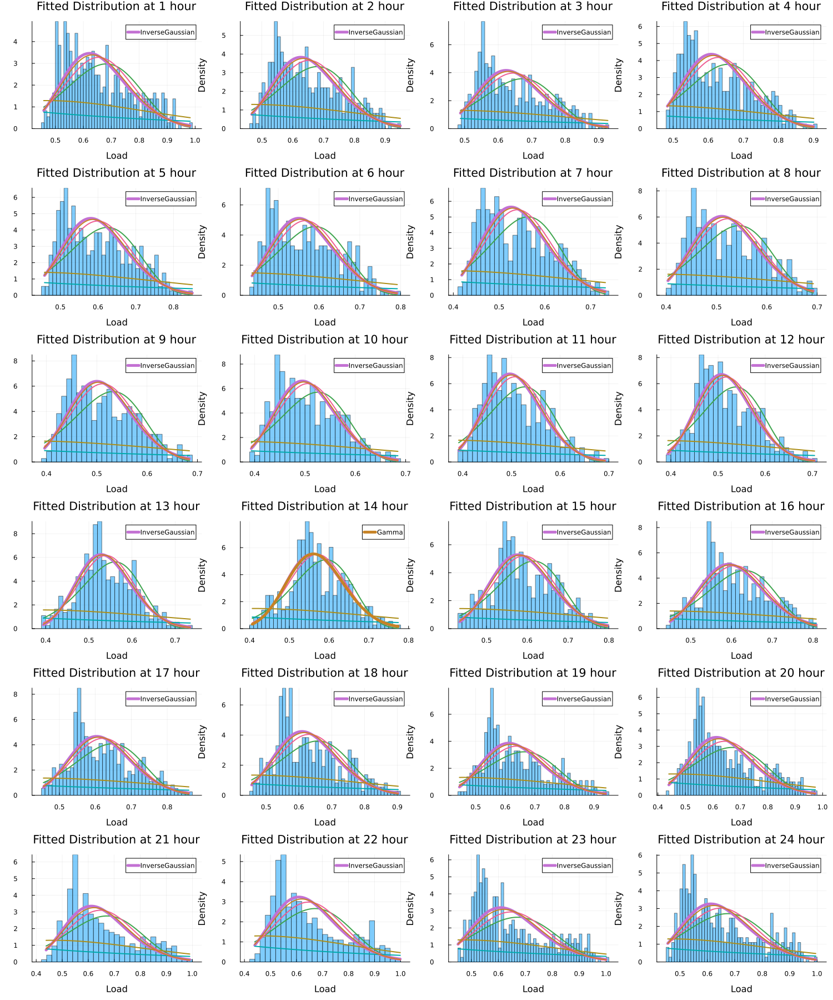

In [ ]:
plot(layout=(6,4), size=(1500, 6*300))
sp=1
for h in 1:24
    F = FITS[h]
    # Plot the empirical distribution
    plt = histogram!(subplot=sp, load_by_hour[h], normalize=true, alpha=0.5,  bins=50, label=false)

    # Plot the fitted Weibull distribution
    x = range(minimum(load_by_hour[h]), stop=maximum(load_by_hour[h]), length=100)

    best_dist = argmax([loss for (_, (_, loss)) in F])
    best_dist = [dist for (dist, (_, _)) in F][best_dist]
    
    for (dist, (fit, loss)) in F
        y = pdf.(fit, x)
        if dist == best_dist
            s = 5
            plot!(subplot=sp, x, y, label=string(dist), linewidth=s)
        else
            s=2
            plot!(subplot=sp, x, y, linewidth=s, label=false)
        end
    end

    # Add labels and legend
    xlabel!(subplot=sp, "Load")
    ylabel!(subplot=sp, "Density")
    title!(subplot=sp, "Fitted Distribution at $h hour")
    #legend!(subplot=sp)
    #display(plt)
    sp+=1
end
display(plt)

# By hour and season

In [ ]:
load_by_hour_season = Dict(season => Dict() for season in ["winter", "spring", "summer", "fall"])

for h in 0:23, season in ["winter", "spring", "summer", "fall"]
    load_by_hour_season[season][h+1] = load[(load[:, :hour] .== h).&&(load[:, :season] .== season), :load]/max_l
end

FITS = Dict(season => Dict(h => Dict() for  h in 1:24) for season in ["winter", "spring", "summer", "fall"])
for  h in 1:24, season in ["winter", "spring", "summer", "fall"]
    min_loss = -Inf
    best_dist = nothing
    for dist in distributions
        #println(dist)
        data = load_by_hour_season[season][h]
        fit = fit_mle(dist, data)
        #println(fit)
        loss = sum(logpdf.(fit, data))
        if loss > min_loss
            min_loss = loss
            best_dist = dist
        end
        #println("Loss: ", loss)
        FITS[season][h][dist] = (fit, loss)
    end
end

In [ ]:
total_min_loss = 0

for season in ["winter", "spring", "summer", "fall"], h in 1:24
    results = FITS[season][h]
    best_dist = argmax([loss for (_, (_, loss)) in results])
    best_dist = [dist for (dist, (_, _)) in results][best_dist]
    println("Best distribution for $season at hour $h: ", best_dist)
    total_min_loss += results[best_dist][2]
end

#sum(maximum([loss for (_, (_, loss)) in FITS[h]]) for h in 1:24)



println("Total minimum loss: ", total_min_loss)

Best distribution for winter at hour 1: Gamma
Best distribution for winter at hour 2: InverseGaussian
Best distribution for winter at hour 3: InverseGaussian
Best distribution for winter at hour 4: InverseGaussian
Best distribution for winter at hour 5: Gamma
Best distribution for winter at hour 6: Gamma
Best distribution for winter at hour 7: InverseGaussian
Best distribution for winter at hour 8: InverseGaussian
Best distribution for winter at hour 9: InverseGaussian
Best distribution for winter at hour 10: InverseGaussian
Best distribution for winter at hour 11: InverseGaussian
Best distribution for winter at hour 12: InverseGaussian
Best distribution for winter at hour 13: Gamma
Best distribution for winter at hour 14: Normal
Best distribution for winter at hour 15: Normal
Best distribution for winter at hour 16: Normal
Best distribution for winter at hour 17: Gamma
Best distribution for winter at hour 18: InverseGaussian
Best distribution for winter at hour 19: LogNormal
Best dist

In [ ]:
plt = plot(layout=(2*24,4), size=(1500, 2*24*300))
sp=1
for  h in 1:24
    for season in ["winter", "spring", "summer", "fall"]
        F = FITS[season][h]
        # Plot the empirical distribution
        data = load_by_hour_season[season][h]
        histogram!(subplot=sp, data, normalize=true, alpha=0.5, bins=50, label=false)

        # Plot the fitted Weibull distribution
        x = range(minimum(data), stop=maximum(data), length=100)

        best_dist = argmax([loss for (_, (_, loss)) in F])
        best_dist = [dist for (dist, (_, _)) in F][best_dist]
        
        for (dist, (fit, loss)) in F
            y = pdf.(fit, x)
            if dist == best_dist
                s = 5
                plot!(subplot=sp, x, y, label=string(dist), linewidth=s)
            else
                s=2
                plot!(subplot=sp, x, y, linewidth=s, label=false)
            end
        end

        # Add labels and legend
        #xlabel!(subplot=sp, "Load")
        #ylabel!(subplot=sp, "Density")
        title!(subplot=sp, "$season at $h hour")

        # Sort the FITS dictionary by loss in decreasing order
        sorted_fits = sort(collect(F), by=x -> x[2][2], rev=true)

        # Create a new plot for the loss plot
        bar!(subplot=sp+4, string.(first.(sorted_fits)), [loss for (_, (_, loss)) in sorted_fits], alpha=0.7, xrotation=45)
    #    xlabel!("Distribution")
    #   ylabel!("Loss")
        title!("Loss per Distribution")

        sp+=1
    end
    sp+=4
end
#display(plt)

In [ ]:
# Create a DataFrame to store the FITS data
fits_df = DataFrame(Season=String[], Hour=Int[], Model=String[], Parameters=Any[], Log_likelihood=Float64[])

# Populate the DataFrame with the best FITS data
for season in ["winter", "spring", "summer", "fall"], h in 1:24
    F = FITS[season][h]
    best_dist = argmax([loss for (_, (_, loss)) in F])
    best_dist, (best_fit, best_loss) = [(dist, (fit, loss)) for (dist, (fit, loss)) in F][best_dist]
    push!(fits_df, (season, h, string(best_dist), best_fit, best_loss))
end

# Display the DataFrame
println(fits_df)
# Export the DataFrame to a CSV file
CSV.write("load_fits.csv", fits_df)


96×5 DataFrame
 Row │ Season  Hour   Model            Parameters                         Log_likelihood 
     │ String  Int64  String           Any                                Float64        
─────┼───────────────────────────────────────────────────────────────────────────────────
   1 │ winter      1  Gamma            Gamma{Float64}(α=68.137, θ=0.009…        106.124
   2 │ winter      2  InverseGaussian  InverseGaussian{Float64}(μ=0.636…        111.017
   3 │ winter      3  InverseGaussian  InverseGaussian{Float64}(μ=0.632…        115.001
   4 │ winter      4  InverseGaussian  InverseGaussian{Float64}(μ=0.621…        116.622
   5 │ winter      5  Gamma            Gamma{Float64}(α=78.5341, θ=0.00…        118.431
   6 │ winter      6  Gamma            Gamma{Float64}(α=73.8498, θ=0.00…        119.208
   7 │ winter      7  InverseGaussian  InverseGaussian{Float64}(μ=0.554…        123.814
   8 │ winter      8  InverseGaussian  InverseGaussian{Float64}(μ=0.540…        125.079
   9 │ wint

"load_fits.csv"

In [ ]:
load_fits = CSV.read("DATA/load_fits.csv", DataFrame)

Row,Season,Hour,Model,Parameters,Log_likelihood
,String7,Int64,String15,String,Float64
1,winter,1,Gamma,"Gamma{Float64}(α=68.1370095150785, θ=0.009059462155238477)",106.124
2,winter,2,InverseGaussian,"InverseGaussian{Float64}(μ=0.6362679718057194, λ=46.93061472901635)",111.017
3,winter,3,InverseGaussian,"InverseGaussian{Float64}(μ=0.6320491032249692, λ=50.189852096733084)",115.001
4,winter,4,InverseGaussian,"InverseGaussian{Float64}(μ=0.6215039988799573, λ=49.41603858268835)",116.622
5,winter,5,Gamma,"Gamma{Float64}(α=78.53413538722886, θ=0.007674109747789907)",118.431
6,winter,6,Gamma,"Gamma{Float64}(α=73.84975021389418, θ=0.00785008484522946)",119.208
7,winter,7,InverseGaussian,"InverseGaussian{Float64}(μ=0.5548338350600319, λ=40.982388335552486)",123.814
8,winter,8,InverseGaussian,"InverseGaussian{Float64}(μ=0.5409362152852826, λ=39.00759539789951)",125.079
9,winter,9,InverseGaussian,"InverseGaussian{Float64}(μ=0.5322740855254445, λ=37.79717289755328)",125.881


In [ ]:
season = "winter"
hour = 1
# Extract the best fitted model for the first row from the load_fits DataFrame
first_row = load_fits[(load_fits.Season .== season) .&& (load_fits.Hour .== hour), :]
best_model = first_row.Model[1]
parameters = first_row.Parameters[1]



# Generate a random value using the best fitted model
if best_model == "LogNormal"
    μ = parse(Float64, match(r"μ=([0-9.]+)", parameters).captures[1])
    σ = parse(Float64, match(r"σ=([0-9.]+)", parameters).captures[1])
    fit = LogNormal(μ, σ)
elseif best_model == "Gamma"
    α = parse(Float64, match(r"α=([0-9.]+)", parameters).captures[1])
    θ = parse(Float64, match(r"θ=([0-9.]+)", parameters).captures[1])
    fit = Gamma(α, θ)
elseif best_model == "Weibull"
    α = parse(Float64, match(r"α=([0-9.]+)", parameters).captures[1])
    θ = parse(Float64, match(r"θ=([0-9.]+)", parameters).captures[1])
    fit = Weibull(α, θ)
elseif best_model == "Normal"
    μ = parse(Float64, match(r"μ=([0-9.]+)", parameters).captures[1])
    σ = parse(Float64, match(r"σ=([0-9.]+)", parameters).captures[1])
    fit = Normal(μ, σ)
elseif best_model == "InverseGaussian"
    μ = parse(Float64, match(r"μ=([0-9.]+)", parameters).captures[1])
    λ = parse(Float64, match(r"λ=([0-9.]+)", parameters).captures[1])
    fit = InversGaussian(μ, λ)
else
    error("Unsupported model: $best_model")
end

# Generate a random value
random_value = rand(fit)
println("Generated random value using $best_model: ", random_value)

Generated random value using Gamma: 0.6219649224638835


In [ ]:
include("scenario_generation.jl")

sample_load (generic function with 1 method)

In [ ]:
for season in ["winter", "spring", "summer", "fall"], h in 1:24
    s = sample_load(season, h)
    println(season, " ", h, " ", s)
end
    

winter 1 0.5136194203241621
winter 2 0.8283005424532889
winter 3 0.5598289737913551
winter 4 0.7155735855925908
winter 5 0.7390540986635936
winter 6 0.524658904441927
winter 7 0.51148000540639
winter 8 0.4620590326443297
winter 9 0.48377889481407055
winter 10 0.584473948164029
winter 11 0.5788153579301897
winter 12 0.6174894909155341
winter 13 0.7210873897826765
winter 14 0.5936673568047229
winter 15 0.6191352931178007
winter 16 0.6452565241088803
winter 17 0.6818402473575469
winter 18 0.6518268211237475
winter 19 0.7845727190706805
winter 20 0.9716058676928112
winter 21 0.8283923260801392
winter 22 0.7943443316707413
winter 23 0.8598066118723298
winter 24 0.8804577756496679
spring 1 0.5473296004335442
spring 2 0.846426107695635
spring 3 0.8812209723014992
spring 4 0.972817174985514
spring 5 0.9883203426063142
spring 6 0.9567759552570734
spring 7 0.9108271618721946
spring 8 0.994045288117925
spring 9 0.9653774712719969
spring 10 0.757750725059588
spring 11 0.8923997264656177
spring 12 

# capacity factor

In [34]:
cf = CSV.read("DATA/Capacity_factor/capacity_factor.csv", DataFrame)
distributions = [Exponential, LogNormal, Normal, Gamma, Laplace,#= Pareto,=# Rayleigh, InverseGaussian,#= Uniform,=# Weibull]

8-element Vector{UnionAll}:
 Exponential
 LogNormal
 Normal
 Gamma
 Laplace
 Rayleigh
 InverseGaussian
 Weibull

In [3]:
FITS = Dict()
min_loss = -Inf
best_dist = nothing
data =cf[:, :"Capacity factor"]
println(minimum(data))
println(data)
println("Are there NaNs in the data? ", any(isnan, data))
println("Are all values non-negative? ", all(x -> x >= 0, data))

0.0001
[0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.011483634, 0.236699815, 0.015611024, 0.028359568, 0.035987356, 0.047272624, 0.035241227, 0.013054042, 0.262658048, 0.020587299, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.000596725, 0.075345646, 0.036630771, 0.055903111, 0.23257565, 0.031963915, 0.029464839, 0.016592414, 0.021534167, 0.001656343, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.023070322, 0.290522802, 0.505323199, 0.645009234, 0.711780082, 0.706937065, 0.644681063, 0.512217645, 0.308661742, 0.034340531, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.003271445, 0.234811763, 0.226117346, 0.511378037, 0.597243927, 0.671010087, 0.625026282, 0.497545106, 0.302126723, 0.03394289, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.0001, 0.

In [4]:
for dist in distributions
    try
        fit = fit_mle(dist, data)
        loss = sum(logpdf.(fit, data))
        if loss > min_loss
            min_loss = loss
            best_dist = dist
        end
        FITS[dist] = (fit, loss)
    catch e
        println("Failed to fit distribution $dist: $e")
    end
end

Failed to fit distribution Weibull: DomainError(NaN, "Weibull: the condition α > zero(α) is not satisfied.")


In [5]:
FITS = Dict()
min_loss = -Inf
best_dist = nothing
data =cf[:, :"Capacity factor"].+1
println(minimum(data))
println(data)
println("Are there NaNs in the data? ", any(isnan, data))
println("Are all values non-negative? ", all(x -> x >= 0, data))
for dist in distributions
    #println(dist)
    fit = fit_mle(dist, data)
    #println(fit)
    loss = sum(logpdf.(fit, data))
    if loss > min_loss
        min_loss = loss
        best_dist = dist
    end
    #println("Loss: ", loss)
    FITS[dist] = (fit, loss)
end

1.0001
[1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.011483634, 1.236699815, 1.015611024, 1.028359568, 1.035987356, 1.047272624, 1.035241227, 1.013054042, 1.262658048, 1.020587299, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.000596725, 1.075345646, 1.036630771, 1.055903111, 1.23257565, 1.031963915, 1.029464839, 1.016592414, 1.021534167, 1.001656343, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.023070322, 1.290522802, 1.505323199, 1.645009234, 1.711780082, 1.706937065, 1.6446810630000002, 1.512217645, 1.308661742, 1.034340531, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.003271445, 1.234811763, 1.226117346, 1.511378037, 1.597243927, 1.671010087, 1.6250262819999999, 1.497545106, 1.302126723, 1.03394289, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.0001, 1.00

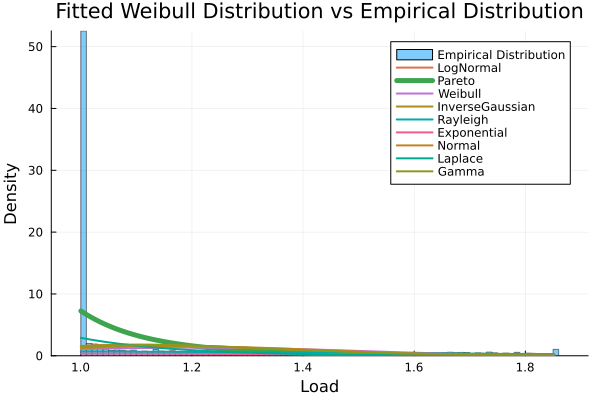

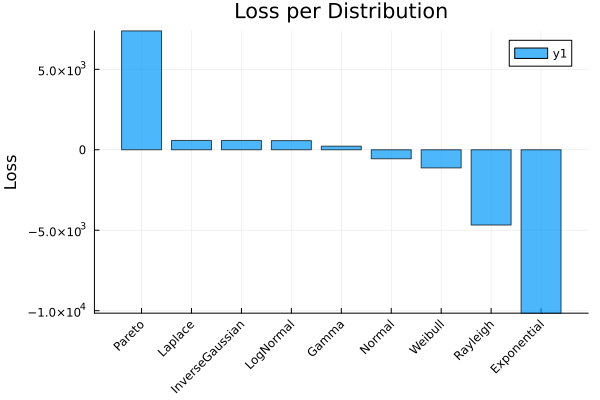

Best distribution'l loss : 7386.804946644692


In [6]:
# Plot the empirical distribution
plt = histogram(data, normalize=true, alpha=0.5, label="Empirical Distribution", bins=100)

# Plot the fitted Weibull distribution
x = range(minimum(data), stop=maximum(data), length=100)

for (dist, (fit, loss)) in FITS
    if dist == best_dist
        s = 5
    else
        s=2
    end
    y = pdf.(fit, x)
    plot!(x, y, label=string(dist), linewidth=s)
end

# Add labels and legend
xlabel!("Load")
ylabel!("Density")
title!("Fitted Weibull Distribution vs Empirical Distribution")
display(plt)


# Sort the FITS dictionary by loss in decreasing order
sorted_fits = sort(collect(FITS), by=x -> x[2][2], rev=true)

# Create a new plot for the loss plot
plt = bar(string.(first.(sorted_fits)), [loss for (_, (_, loss)) in sorted_fits], alpha=0.7, xrotation=45)
xlabel!("Distribution")
ylabel!("Loss")
title!("Loss per Distribution")
display(plt)

println("Best distribution'l loss : ", maximum([loss for (_, (_, loss)) in sorted_fits]))

# By season

In [7]:
cf_by_season = Dict()
for season in ["winter", "spring", "summer", "fall"]
    cf_by_season[season] = cf[cf[:, :season] .== season, :"Capacity factor"].+1
end

FITS = Dict(season => Dict() for season in ["winter", "spring", "summer", "fall"])
for season in ["winter", "spring", "summer", "fall"]
    min_loss = -Inf
    best_dist = nothing
    for dist in distributions
        #println(dist)
        data = cf_by_season[season]
        fit = fit_mle(dist, data)
        #println(fit)
        loss = sum(logpdf.(fit, data))
        if loss > min_loss
            min_loss = loss
            best_dist = dist
        end
        #println("Loss: ", loss)
        FITS[season][dist] = (fit, loss)
    end
end

In [8]:
total_min_loss = sum(maximum([loss for (_, (_, loss)) in FITS[season]]) for season in ["winter", "spring", "summer", "fall"])
println("Total minimum loss: ", total_min_loss)

Total minimum loss: 7551.416088987294


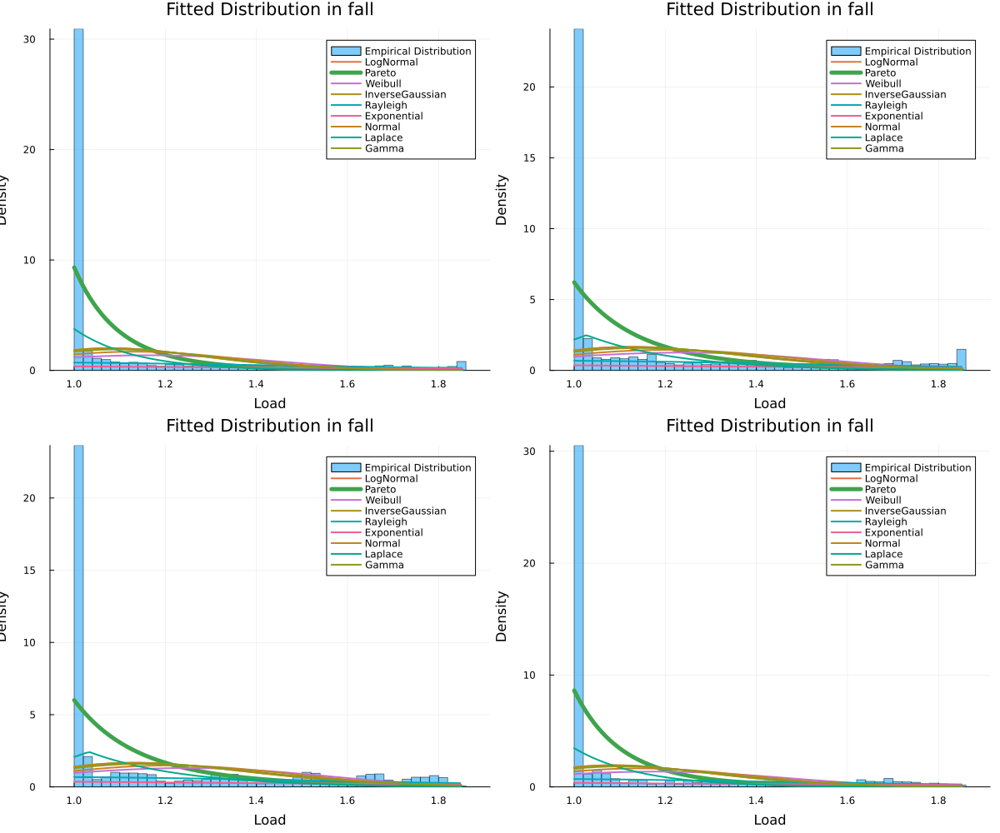

In [9]:
plot(layout=(2, 2), size=(1200, 1000))
sp = 1
for season in ["winter", "spring", "summer", "fall"]
    F = FITS[season]
    # Plot the empirical distribution
    plt = histogram!(subplot=sp, cf_by_season[season], normalize=true, alpha=0.5, label="Empirical Distribution", bins=50)

    # Plot the fitted Weibull distribution
    x = range(minimum(cf_by_season[season]), stop=maximum(cf_by_season[season]), length=100)

    best_dist = argmax([loss for (_, (_, loss)) in F])
    best_dist = [dist for (dist, (_, _)) in F][best_dist]

    for (dist, (fit, loss)) in F
        if dist == best_dist
            s = 5
        else
            s=2
        end
        y = pdf.(fit, x)
        plot!(subplot=sp, x, y, label=string(dist), linewidth=s)
    end

    # Add labels and legend
    xlabel!("Load")
    ylabel!("Density")
    title!("Fitted Distribution in $season")
    sp+=1
end
display(plt)

# By hour

In [39]:
cf_by_hour = Dict()
for h in 0:23
    cf_by_hour[h+1] = cf[cf[:, :hour] .== h, :"Capacity factor"].+1
end

FITS = Dict(h => Dict() for  h in 1:24)
for  h in 1:24
    min_loss = -Inf
    best_dist = nothing
    for dist in distributions
        #println(dist)
        data = cf_by_hour[h]
        try
            fit = fit_mle(dist, data)
            #println(fit)
            loss = sum(logpdf.(fit, data))
            if loss > min_loss
                min_loss = loss
                best_dist = dist
            end
            #println("Loss: ", loss)
            FITS[h][dist] = (fit, loss)
        catch
        end
    end
end

In [41]:
total_min_loss = sum([maximum([loss for (_, (_, loss)) in FITS[h]]) for h in 1:24])
println("Total maximum log loss: ", total_min_loss)

Total maximum log loss: 158752.24371069006


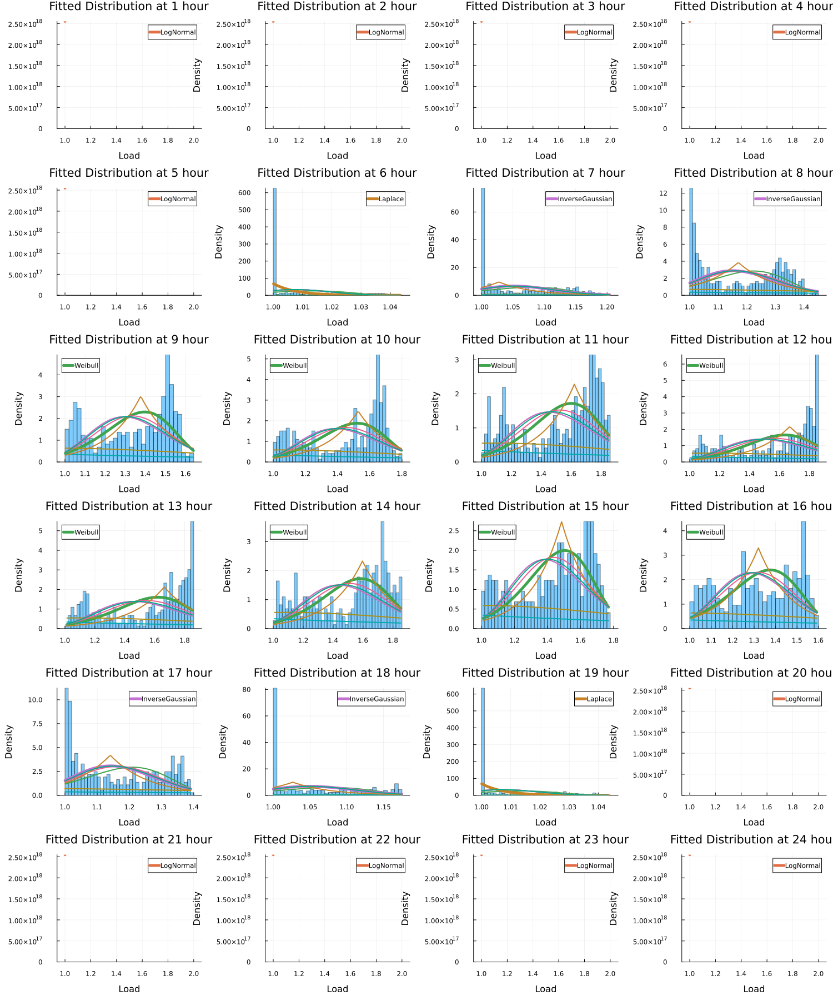

In [42]:
plot(layout=(6,4), size=(1500, 6*300))
sp=1
for h in 1:24
    F = FITS[h]
    # Plot the empirical distribution
    plt = histogram!(subplot=sp, cf_by_hour[h], normalize=true, alpha=0.5,  bins=50, label=false)

    # Plot the fitted Weibull distribution
    x = range(minimum(cf_by_hour[h]), stop=maximum(cf_by_hour[h]), length=100)

    best_dist = argmax([loss for (_, (_, loss)) in F])
    best_dist = [dist for (dist, (_, _)) in F][best_dist]
    
    for (dist, (fit, loss)) in F
        y = pdf.(fit, x)
        if dist == best_dist
            s = 5
            plot!(subplot=sp, x, y, label=string(dist), linewidth=s)
        else
            s=2
            plot!(subplot=sp, x, y, linewidth=s, label=false)
        end
    end

    # Add labels and legend
    xlabel!(subplot=sp, "Load")
    ylabel!(subplot=sp, "Density")
    title!(subplot=sp, "Fitted Distribution at $h hour")
    #legend!(subplot=sp)
    #display(plt)
    sp+=1
end
display(plt)

# By hour and season

In [51]:
cf_by_hour_season = Dict(season => Dict() for season in ["winter", "spring", "summer", "fall"])

for h in 0:23, season in ["winter", "spring", "summer", "fall"]
    cf_by_hour_season[season][h+1] = cf[(cf[:, :hour] .== h).&&(cf[:, :season] .== season), :"Capacity factor"]
end

FITS = Dict(season => Dict(h => Dict() for  h in 1:24) for season in ["winter", "spring", "summer", "fall"])
for  h in 1:24, season in ["winter", "spring", "summer", "fall"]
    min_loss = -Inf
    best_dist = nothing
    for dist in distributions
        #println(dist)
        data = cf_by_hour_season[season][h]
        try
            fit = fit_mle(dist, data)
            #println(fit)
            loss = sum(logpdf.(fit, data))
            if loss > min_loss
                min_loss = loss
                best_dist = dist
            end
            #println("Loss: ", loss)
            FITS[season][h][dist] = (fit, loss)
        catch e
            println(e)
        end
    end
end

DomainError(-4.440892098500626e-15, "log was called with a negative real argument but will only return a complex result if called with a complex argument. Try log(Complex(x)).")
DomainError(0.0, "Laplace: the condition θ > zero(θ) is not satisfied.")
DomainError(-1.8325193796266666e11, "InverseGaussian: the condition λ > zero(λ) is not satisfied.")
DomainError(NaN, "Weibull: the condition α > zero(α) is not satisfied.")
DomainError(-5.329070518200751e-15, "log was called with a negative real argument but will only return a complex result if called with a complex argument. Try log(Complex(x)).")
DomainError(0.0, "Laplace: the condition θ > zero(θ) is not satisfied.")
DomainError(-1.8325193796266666e11, "InverseGaussian: the condition λ > zero(λ) is not satisfied.")
DomainError(NaN, "Weibull: the condition α > zero(α) is not satisfied.")
DomainError(-6.217248937900877e-15, "log was called with a negative real argument but will only return a complex result if called with a complex argumen

In [52]:
FITS

Dict{String, Dict{Int64, Dict{Any, Any}}} with 4 entries:
  "winter" => Dict(5=>Dict(LogNormal=>(LogNormal{Float64}(μ=-9.21034, σ=5.35795…
  "fall"   => Dict(5=>Dict(LogNormal=>(LogNormal{Float64}(μ=-9.21034, σ=3.57307…
  "summer" => Dict(5=>Dict(LogNormal=>(LogNormal{Float64}(μ=-9.21034, σ=5.35795…
  "spring" => Dict(5=>Dict(LogNormal=>(LogNormal{Float64}(μ=-9.21034, σ=5.35859…

In [53]:
total_min_loss = 0

for season in ["winter", "spring", "summer", "fall"], h in 1:24
    results = FITS[season][h]
    println(results)
    best_dist = argmax([loss for (_, (_, loss)) in results])
    best_dist = [dist for (dist, (_, _)) in results][best_dist]
    println("Best distribution for $season at hour $h: ", best_dist)
    total_min_loss += results[best_dist][2]
end

#sum(maximum([loss for (_, (_, loss)) in FITS[h]]) for h in 1:24)



println("Total minimum loss: ", total_min_loss)

Dict{Any, Any}(LogNormal => (LogNormal{Float64}(μ=-9.210340371976176, σ=5.358925488595217e-15), 3659.1273272517487), Rayleigh => (Rayleigh{Float64}(σ=7.071067811865478e-5), 801.3138797282515), Exponential => (Exponential{Float64}(θ=9.999999999999995e-5), 738.9306334778563), Normal => (Normal{Float64}(μ=0.00010000000000000002, σ=1.3552527156068805e-20), 3989.5897845376544))
Best distribution for winter at hour 1: Normal
Dict{Any, Any}(LogNormal => (LogNormal{Float64}(μ=-9.210340371976176, σ=5.3579545808078135e-15), 3781.0984223724427), Rayleigh => (Rayleigh{Float64}(σ=7.071067811865478e-5), 828.02434238586), Exponential => (Exponential{Float64}(θ=9.999999999999994e-5), 763.5616545937847), Normal => (Normal{Float64}(μ=9.999999999999999e-5, σ=1.3552527156068805e-20), 4122.5761106889095))
Best distribution for winter at hour 2: Normal
Dict{Any, Any}(LogNormal => (LogNormal{Float64}(μ=-9.210340371976176, σ=5.3579545808078135e-15), 3781.0984223724427), Rayleigh => (Rayleigh{Float64}(σ=7.0710

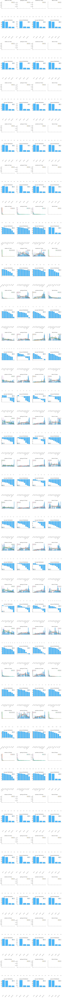

In [58]:
plt = plot(layout=(2*24,4), size=(1500, 2*24*500))
sp=1
for  h in 1:24
    for season in ["winter", "spring", "summer", "fall"]
        F = FITS[season][h]
        # Plot the empirical distribution
        data = cf_by_hour_season[season][h]
        histogram!(subplot=sp, data, normalize=true, alpha=0.5, bins=50, label=false)

        # Plot the fitted Weibull distribution
        x = range(minimum(data), stop=maximum(data), length=100)

        best_dist = argmax([loss for (_, (_, loss)) in F])
        best_dist = [dist for (dist, (_, _)) in F][best_dist]
        
        for (dist, (fit, loss)) in F
            y = pdf.(fit, x)
            if dist == best_dist
                s = 5
                plot!(subplot=sp, x, y, label=string(dist), linewidth=s)
            else
                s=2
                plot!(subplot=sp, x, y, linewidth=s, label=false)
            end
        end

        # Add labels and legend
        #xlabel!(subplot=sp, "Load")
        #ylabel!(subplot=sp, "Density")
        title!(subplot=sp, "$season at $h hour")

        # Sort the FITS dictionary by loss in decreasing order
        sorted_fits = sort(collect(F), by=x -> x[2][2], rev=true)

        # Create a new plot for the loss plot
        bar!(subplot=sp+4, string.(first.(sorted_fits)), [loss for (_, (_, loss)) in sorted_fits], alpha=0.7, xrotation=45)
    #    xlabel!("Distribution")
    #   ylabel!("Loss")
        title!(subplot=sp+4, "Loss per Distribution")

        sp+=1
    end
    sp+=4
end
display(plt)

In [62]:
include("scenario_generation.jl")

sample_cf (generic function with 1 method)

In [63]:
for season in ["winter", "spring", "summer", "fall"], h in 1:24
    s = sample_cf(season, h)
    println(season, " ", h, " ", s)
end

winter 1 0.0001
winter 2 0.0001
winter 3 0.0001
winter 4 0.0001
winter 5 0.0001
winter 6 0.0001
winter 7 0.0001
winter 8 0.018777809
winter 9 0.130269214
winter 10 0.015832931
winter 11 0.770708908
winter 12 0.834659753
winter 13 0.671010087
winter 14 0.594377042
winter 15 0.487114647
winter 16 0.296696974
winter 17 0.320387839
winter 18 0.022526779
winter 19 0.0001
winter 20 0.0001
winter 21 0.0001
winter 22 0.0001
winter 23 0.0001
winter 24 0.0001
spring 1 0.0001
spring 2 0.0001
spring 3 0.0001
spring 4 0.0001
spring 5 0.0001
spring 6 0.0001
spring 7 0.154970877
spring 8 0.061959937
spring 9 0.25041057
spring 10 0.737823554
spring 11 0.78502202
spring 12 0.834965194
spring 13 0.220775678
spring 14 0.177701378
spring 15 0.44748828
spring 16 0.182059952
spring 17 0.336115926
spring 18 0.003555846
spring 19 0.019761756
spring 20 0.0001
spring 21 0.0001
spring 22 0.0001
spring 23 0.0001
spring 24 0.0001
summer 1 0.0001
summer 2 0.0001
summer 3 0.0001
summer 4 0.0001
summer 5 0.0001
summe

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
import seaborn as sns

## Load

Python

In [ ]:
# Define a function to determine the season
def get_season(date):
    year = date.year
    seasons = {'spring': (pd.Timestamp(year=year, month=3, day=21), pd.Timestamp(year=year, month=6, day=20)),
               'summer': (pd.Timestamp(year=year, month=6, day=21), pd.Timestamp(year=year, month=9, day=22)),
               'fall': (pd.Timestamp(year=year, month=9, day=23), pd.Timestamp(year=year, month=12, day=20))}
    if seasons['spring'][0] <= date <= seasons['spring'][1]:
        return 'spring'
    elif seasons['summer'][0] <= date <= seasons['summer'][1]:
        return 'summer'
    elif seasons['fall'][0] <= date <= seasons['fall'][1]:
        return 'fall'
    else:
        return 'winter'

In [ ]:
demand = pd.read_csv('DATA/Load/demand.csv') #1 year of hourly demand for each us state
zone = pd.read_csv('DATA/Load/zone.csv') #index for each zone and state

illinois_id = zone.loc[zone["zone_name"]=="Illinois Downstate"]["zone_id"].values[0]
illinois_load = demand[str(illinois_id)].to_numpy()
time = demand["UTC Time"].to_numpy(dtype='datetime64')

load = pd.DataFrame({"time":time, "load":illinois_load})

#add an hour column 
load['hour'] = load['time'].dt.hour
# Add a season column to the DataFrame
load['season'] = load['time'].apply(get_season)

load.to_csv('DATA/Load/load.csv', index=False)

In [ ]:
load

,time,load,hour,season
0,2016-01-01 00:00:00,5228.379425,0,winter
1,2016-01-01 01:00:00,5115.326989,1,winter
2,2016-01-01 02:00:00,4991.177947,2,winter
3,2016-01-01 03:00:00,4848.896786,3,winter
4,2016-01-01 04:00:00,4711.839312,4,winter
...,...,...,...,...
8779,2016-12-31 19:00:00,4500.053636,19,winter
8780,2016-12-31 20:00:00,4450.655715,20,winter
8781,2016-12-31 21:00:00,4431.901967,21,winter
8782,2016-12-31 22:00:00,4433.252763,22,winter


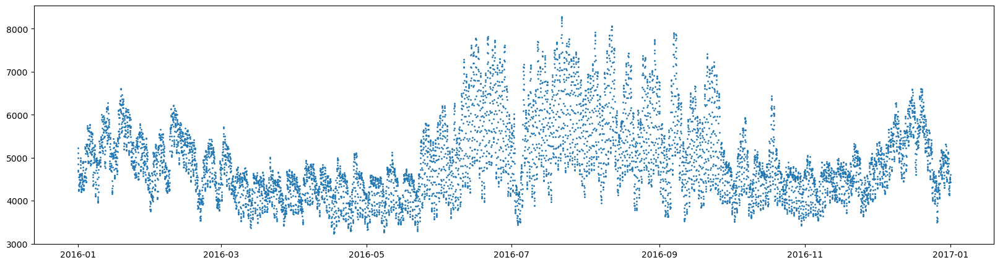

In [ ]:
plt.figure(figsize=(20,5))
plt.scatter(load["time"], load["load"], s=1)

In [ ]:
# Define a function to determine the season
def get_season(date):
    year = date.year
    seasons = {'spring': (pd.Timestamp(year=year, month=3, day=21), pd.Timestamp(year=year, month=6, day=20)),
               'summer': (pd.Timestamp(year=year, month=6, day=21), pd.Timestamp(year=year, month=9, day=22)),
               'fall': (pd.Timestamp(year=year, month=9, day=23), pd.Timestamp(year=year, month=12, day=20))}
    if seasons['spring'][0] <= date <= seasons['spring'][1]:
        return 'spring'
    elif seasons['summer'][0] <= date <= seasons['summer'][1]:
        return 'summer'
    elif seasons['fall'][0] <= date <= seasons['fall'][1]:
        return 'fall'
    else:
        return 'winter'

In [ ]:
#add an hour column 
load['hour'] = load['time'].dt.hour
# Add a season column to the DataFrame
load['season'] = load['time'].apply(get_season)



hourly_load = load.groupby('hour')['load']

hourly_load_arrays = {name:group.to_numpy() for name, group in hourly_load}
# Group by season and hour
season_hourly_load = load.groupby(['season', 'hour'])['load']
season_hourly_load_arrays = {name: group.to_numpy() for name, group in season_hourly_load}

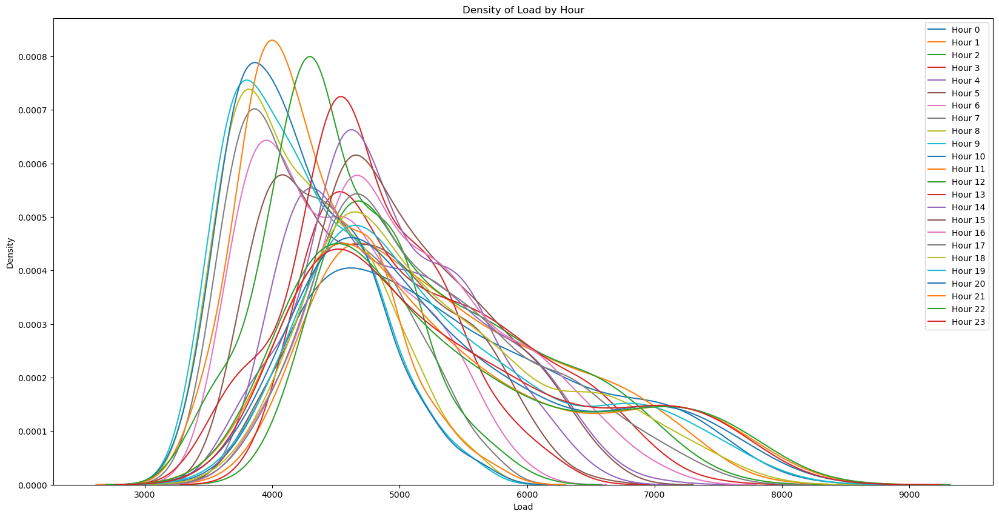

In [ ]:
plt.figure(figsize=(20, 10))
for hour, data in hourly_load_arrays.items():
    sns.kdeplot(data, label=f'Hour {hour}')
plt.title('Density of Load by Hour')
plt.xlabel('Load')
plt.ylabel('Density')
plt.legend()
plt.show()

## Solar capacity factor

In [ ]:
cf_df = pd.read_csv('DATA/Capacity_factor/capacity_factor.csv') #1 year of hourly capacity factor for each us state
time = cf_df["Time stamp"].to_numpy(dtype='datetime64')
#time = np.array(pd.to_datetime(time, format='%b %d, %I:%M %p'), dtype='datetime64')
cf = np.maximum(cf_df["Capacity factor"].to_numpy(), +1e-4)

cf = pd.DataFrame({"time":time, "Capacity factor":cf})

#add an hour column 
cf['hour'] = cf['time'].dt.hour
# Add a season column to the DataFrame
cf['season'] = cf['time'].apply(get_season)

In [6]:
cf

,time,Capacity factor,hour,season
0,1900-01-01 00:00:00,0.0001,0,winter
1,1900-01-01 01:00:00,0.0001,1,winter
2,1900-01-01 02:00:00,0.0001,2,winter
3,1900-01-01 03:00:00,0.0001,3,winter
4,1900-01-01 04:00:00,0.0001,4,winter
...,...,...,...,...
8755,1900-12-31 19:00:00,0.0001,19,winter
8756,1900-12-31 20:00:00,0.0001,20,winter
8757,1900-12-31 21:00:00,0.0001,21,winter
8758,1900-12-31 22:00:00,0.0001,22,winter


In [ ]:
cf.to_csv("DATA/Capacity_factor/capacity_factor.csv", index=False)

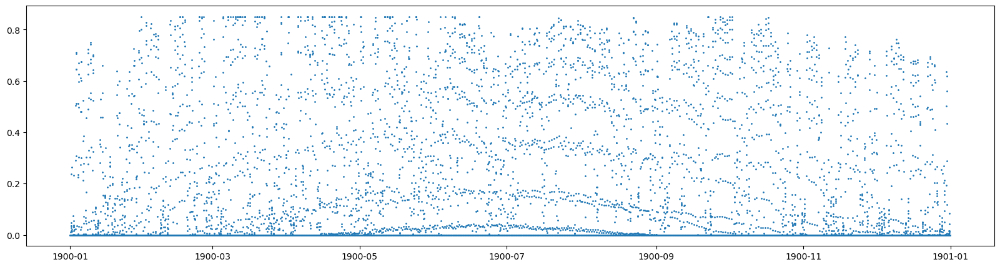

In [ ]:
plt.figure(figsize=(20,5))
plt.scatter(time, cf, s=1)

In [ ]:
cf['hour'] = cf['time'].dt.hour
hourly_cf = cf.groupby('hour')['cf']
hourly_cf_arrays = {name:group.to_numpy() for name, group in hourly_cf}

<Figure size 2000x1000 with 0 Axes>

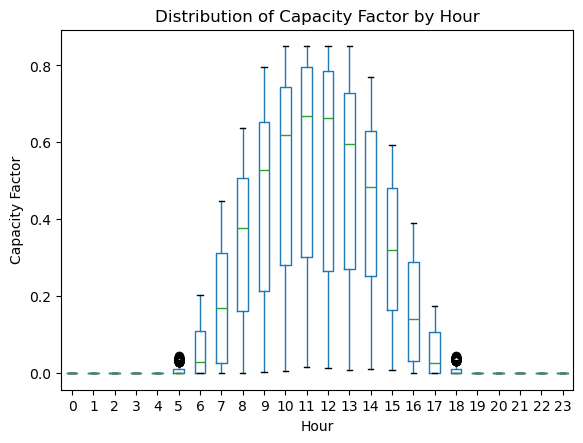

In [ ]:
plt.figure(figsize=(20, 10))
cf.boxplot(column='cf', by='hour', grid=False)
plt.title('Distribution of Capacity Factor by Hour')
plt.suptitle('')
plt.xlabel('Hour')
plt.ylabel('Capacity Factor')
plt.show()

In [ ]:
# Define a function to determine the season
def get_season(date):
    year = date.year
    seasons = {'spring': (pd.Timestamp(year=year, month=3, day=21), pd.Timestamp(year=year, month=6, day=20)),
               'summer': (pd.Timestamp(year=year, month=6, day=21), pd.Timestamp(year=year, month=9, day=22)),
               'fall': (pd.Timestamp(year=year, month=9, day=23), pd.Timestamp(year=year, month=12, day=20))}
    if seasons['spring'][0] <= date <= seasons['spring'][1]:
        return 'spring'
    elif seasons['summer'][0] <= date <= seasons['summer'][1]:
        return 'summer'
    elif seasons['fall'][0] <= date <= seasons['fall'][1]:
        return 'fall'
    else:
        return 'winter'

# Add a season column to the DataFrame
cf['season'] = cf['time'].apply(get_season)

# Group by season and hour
season_hourly_cf = cf.groupby(['season', 'hour'])['cf']
season_hourly_cf_arrays = {name: group.to_numpy() for name, group in season_hourly_cf}

<Figure size 2000x1000 with 0 Axes>

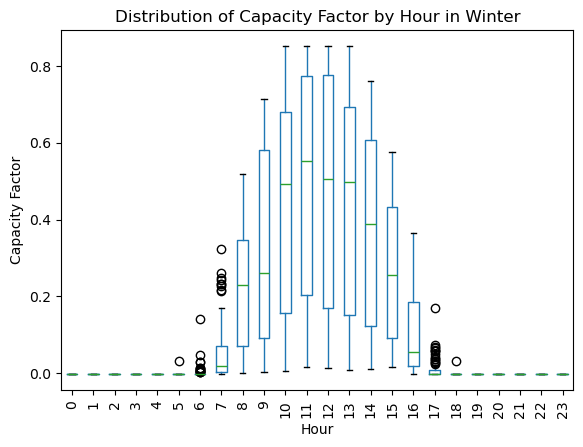

<Figure size 2000x1000 with 0 Axes>

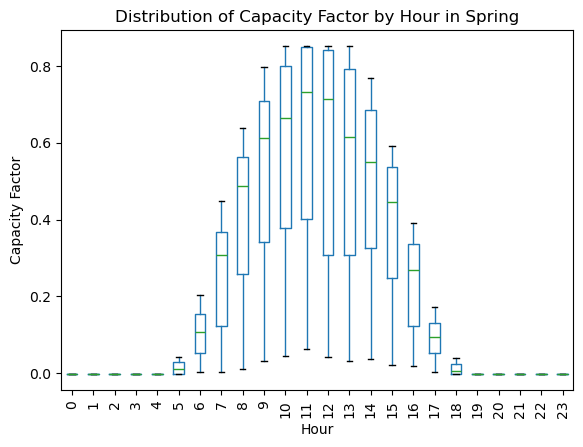

<Figure size 2000x1000 with 0 Axes>

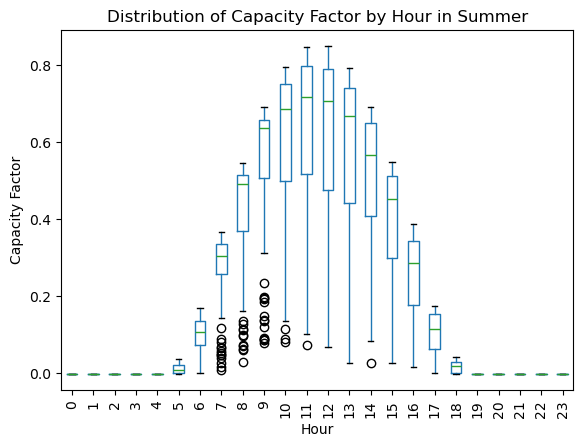

<Figure size 2000x1000 with 0 Axes>

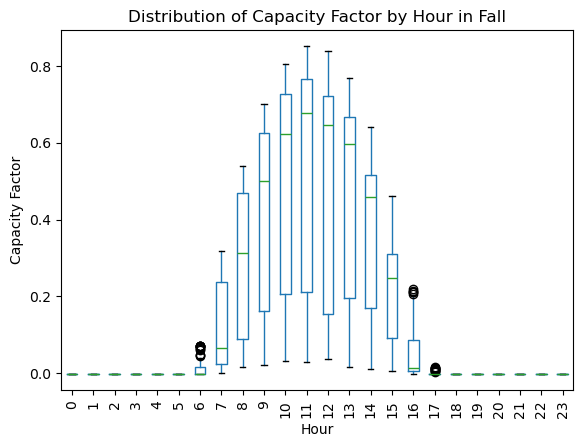

In [ ]:
seasons = cf['season'].unique()

for season in seasons:
    plt.figure(figsize=(20, 10))
    cf_season = cf[cf['season'] == season]
    cf_season.boxplot(column='cf', by='hour', grid=False)
    plt.title(f'Distribution of Capacity Factor by Hour in {season.capitalize()}')
    plt.suptitle('')
    plt.xlabel('Hour')
    plt.ylabel('Capacity Factor')
    plt.xticks(rotation=90)
    plt.show()

In [1]:
using Dates

In [10]:
now = Dates.now()
for i in 1:1000000
    x = rand(1:i)
end
then = Dates.now()  

diff = Dates.value(then - now) / 1000

0.025